In [3]:
import pandas as pd

MASKS = '../input/train.csv'
df_masks = pd.read_csv(MASKS)
df_masks

,id,encoding
0,2f6ecfcdf,296084587 4 296115835 6 296115859 14 296147109...
1,8242609fa,96909968 56 96941265 60 96972563 64 97003861 6...
2,aaa6a05cc,30989109 59 31007591 64 31026074 68 31044556 7...
3,cb2d976f4,78144363 5 78179297 15 78214231 25 78249165 35...
4,b9a3865fc,61271840 4 61303134 13 61334428 22 61365722 30...
5,b2dc8411c,56157731 21 56172571 45 56187411 51 56202252 5...
6,0486052bb,101676003 6 101701785 8 101727568 9 101753351 ...
7,e79de561c,7334642 14 7350821 41 7367001 67 7383180 82 73...
8,095bf7a1f,113277795 21 113315936 53 113354083 87 1133922...
9,54f2eec69,124967057 36 124997425 109 125027828 147 12505...


In [4]:
df_masks.id

0     2f6ecfcdf
1     8242609fa
2     aaa6a05cc
3     cb2d976f4
4     b9a3865fc
5     b2dc8411c
6     0486052bb
7     e79de561c
8     095bf7a1f
9     54f2eec69
10    4ef6695ce
11    26dc41664
12    c68fe75ea
13    afa5e8098
14    1e2425f28
15    aa05346ff
16    2ec3f1bb9
17    3589adb90
18    d488c759a
19    57512b7f1
Name: id, dtype: object

In [3]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from PIL import Image
import tifffile as tiff
import cv2
import os
from tqdm.notebook import tqdm
import zipfile
import rasterio
from rasterio.windows import Window
from torch.utils.data import Dataset
import gc

sz = 1024
reduce = 1
MASKS = '../input/train.csv'
DATA = '../input/train'
OUT_TRAIN = '../hubmap1024/train.zip'
OUT_MASKS = '../hubmap1024/masks.zip'

def enc2mask(encs, shape):
    img = np.zeros(shape[0]*shape[1], dtype=np.uint8)
    for m, enc in enumerate(encs):
        if isinstance(enc, np.float) and np.isnan(enc): continue
        s = enc.split()
        for i in range(len(s)//2):
            start = int(s[2*i]) - 1
            length = int(s[2*i+1])
            img[start:start+length] = 1 + m
    return img.reshape(shape).T

def mask2enc(mask, n=1):
    pixels = mask.T.flatten()
    encs = []
    for i in range(1, n+1):
        p = (pixels == i).astype(np.int8)
        if p.sum() == 0: encs.append(np.nan)
        else:
            p = np.concatenate([[0], p, [0]])
            runs = np.where(p[1:] != p[:-1])[0] + 1
            runs[1::2] -= runs[::2]
            encs.append(' '.join(str(x) for x in runs))
    return encs

df_masks = pd.read_csv(MASKS).set_index('id')

s_th = 40
p_th = 1000 * (sz//256) ** 2

class HubMAPDataset(Dataset):
    def __init__(self, idx, sz=sz, reduce=reduce, encs=None):
        self.data = rasterio.open(os.path.join(DATA, idx+'.tiff'), num_threads=12)
        if self.data.count != 3:
            subdatasets = self.data.subdatasets
            self.layers = []
            if len(subdatasets) > 0:
                for i, subdataset in enumerate(subdatasets, 0):
                    self.layers.append(rasterio.open(subdataset))
        self.shape = self.data.shape
        self.reduce = reduce
        self.sz = reduce * sz #1024
        self.pad0 = (self.sz - self.shape[0]%self.sz) % self.sz
        self.pad1 = (self.sz - self.shape[1]%self.sz) % self.sz
        self.n0max = (self.shape[0] + self.pad0) // self.sz
        self.n1max = (self.shape[1] + self.pad1) // self.sz
        self.mask = enc2mask(encs, (self.shape[1], self.shape[0])) if encs is not None else None

    def __len__(self):
        return self.n0max * self.n1max # 也就是当前这个tiff最多有n0max*n1max个patches
    
    def __getitem__(self, idx):#这个idx是for i in range(len(dataset)) 这么来的
        n0, n1 = idx//self.n1max, idx%self.n1max
        x0, y0 = -self.pad0//2 + n0*self.sz, -self.pad1//2 + n1*self.sz
        p00, p01 = max(0, x0), min(x0+self.sz, self.shape[0])
        p10, p11 = max(0, y0), min(y0+self.sz, self.shape[1])
        img = np.zeros((self.sz, self.sz, 3), np.uint8)
        mask = np.zeros((self.sz, self.sz), np.uint8)

        if self.data.count == 3:
            img[(p00-x0):(p01-x0),(p10-y0):(p11-y0)] = np.moveaxis(self.data.read([1,2,3],
                window=Window.from_slices((p00,p01),(p10,p11))), 0, -1)
        else:
            for i,layer in enumerate(self.layers):
                img[(p00-x0):(p01-x0),(p10-y0):(p11-y0),i] =\
                  layer.read(1,window=Window.from_slices((p00,p01),(p10,p11)))
        if self.mask is not None: mask[(p00-x0):(p01-x0),(p10-y0):(p11-y0)] = self.mask[p00:p01,p10:p11]
        
        if self.reduce != 1:
            img = cv2.resize(img,(self.sz//reduce,self.sz//reduce),
                             interpolation = cv2.INTER_AREA)
            mask = cv2.resize(mask,(self.sz//reduce,self.sz//reduce),
                             interpolation = cv2.INTER_NEAREST)

        hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
        h, s, v = cv2.split(hsv)

        return img, mask, (-1 if (s > s_th).sum() <= p_th or img.sum() <= p_th else idx)

x_tot, x2_tot = [], []
with zipfile.ZipFile(OUT_TRAIN, 'w') as img_out,\
    zipfile.ZipFile(OUT_MASKS, 'w') as mask_out:
    for index, encs in tqdm(df_masks.iterrows(), total=len(df_masks)):
        ds = HubMAPDataset(index, encs=encs)
        for i in range(len(ds)):
            im, m, idx = ds[i]
            if idx < 0: continue
            x_tot.append((im/255.0).reshape(-1, 3).mean(0))
            x2_tot.append(((im/255.0)**2).reshape(-1, 3).mean(0))

            im = cv2.imencode('.png', cv2.cvtColor(im, cv2.COLOR_RGB2BGR))[1]
            img_out.writestr(f'{index}_{idx:04d}.png', im)
            m = cv2.imencode('.png', m)[1]
            mask_out.writestr(f'{index}_{idx:04d}.png', m)

img_avr =  np.array(x_tot).mean(0)
img_std =  np.sqrt(np.array(x2_tot).mean(0) - img_avr**2)
print('mean:',img_avr, ', std:', img_std)


mean: [0.63711163 0.47114376 0.68181989] , std: [0.16736293 0.23051024 0.14848679]


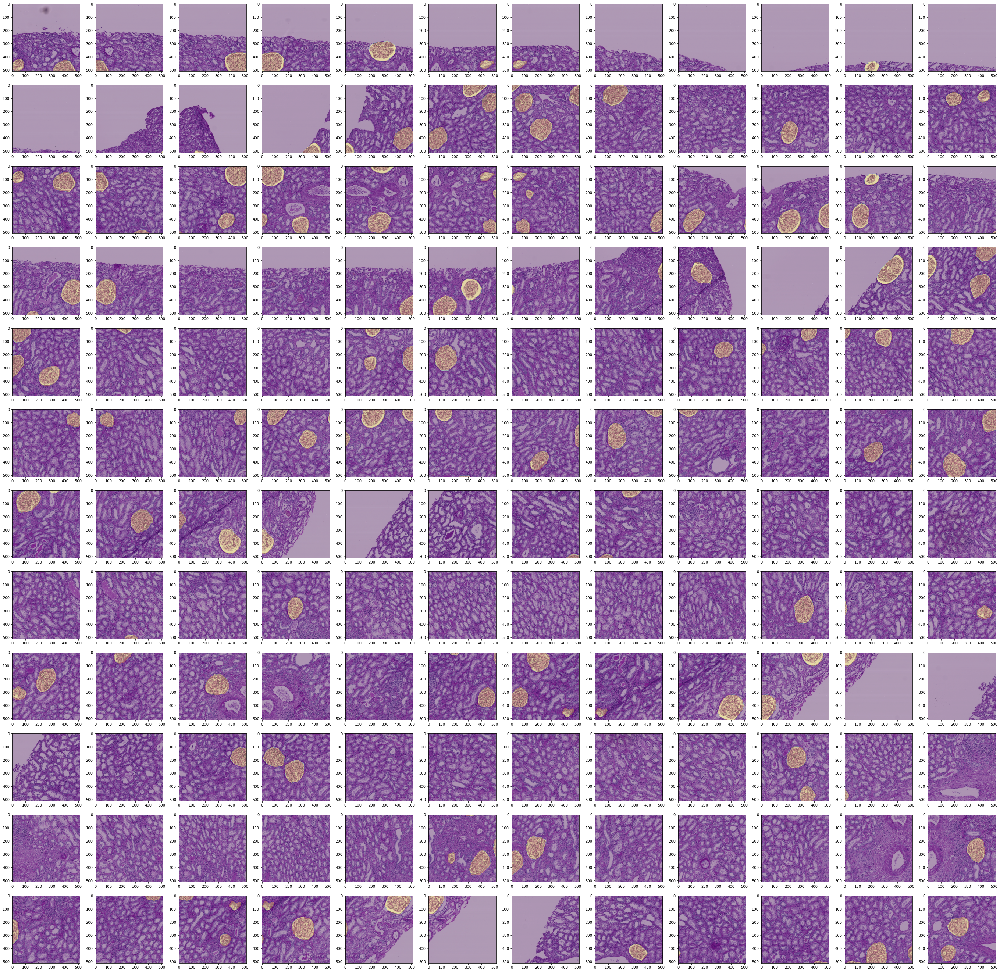

In [11]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from PIL import Image
import tifffile as tiff
import cv2
import os
from tqdm.notebook import tqdm
import zipfile
import rasterio
from rasterio.windows import Window
from torch.utils.data import Dataset
import gc

OUT_TRAIN = '../hubmap512/train.zip'
OUT_MASKS = '../hubmap512/masks.zip'

columns, rows = 12, 12
idx0 = 0
fig = plt.figure(figsize=(columns*4, rows*4))
with zipfile.ZipFile(OUT_TRAIN, 'r') as img_arch,\
    zipfile.ZipFile(OUT_MASKS, 'r') as msk_arch:
    fnames = sorted(img_arch.namelist())[8:]
    for i in range(rows):
        for j in range(columns):
            idx = i + j*columns
            img = cv2.imdecode(np.frombuffer(img_arch.read(fnames[idx0+idx]), np.uint8), cv2.IMREAD_COLOR)
            img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
            mask = cv2.imdecode(np.frombuffer(msk_arch.read(fnames[idx0+idx]), 
                                              np.uint8), cv2.IMREAD_GRAYSCALE)
    
            fig.add_subplot(rows, columns, idx+1)
            plt.axis('on')
            plt.imshow(Image.fromarray(img))
            plt.imshow(Image.fromarray(mask), alpha=0.3)
plt.show()